In [3]:
# Install necessary libraries
!pip install mediapipe opencv-python-headless matplotlib



In [4]:
from google.colab import files
uploaded = files.upload()

# Retrieve the uploaded file path
video_path = list(uploaded.keys())[0]
print(f"Uploaded video: {video_path}")

Saving 4608974-hd_1080_1920_25fps.mp4 to 4608974-hd_1080_1920_25fps.mp4
Uploaded video: 4608974-hd_1080_1920_25fps.mp4


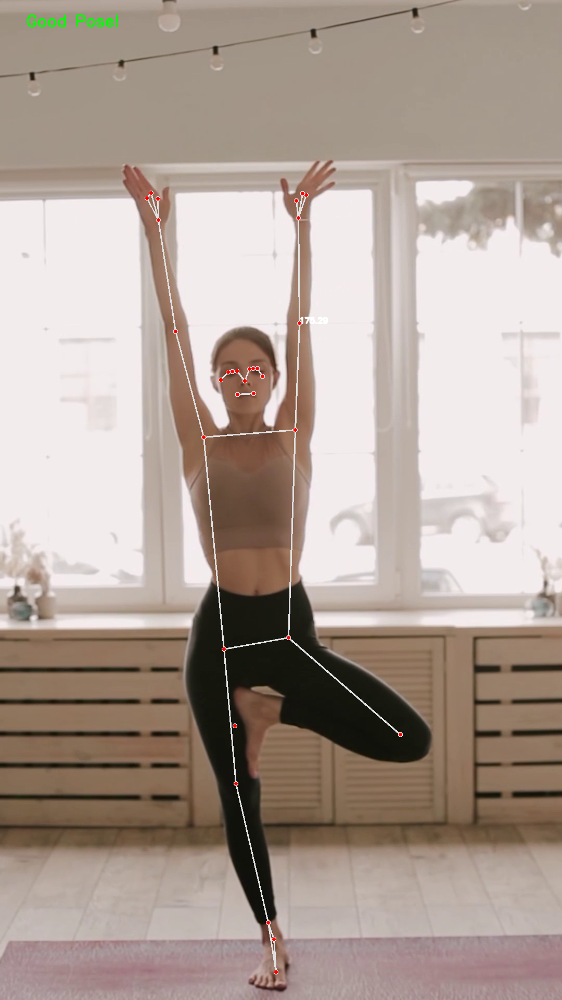

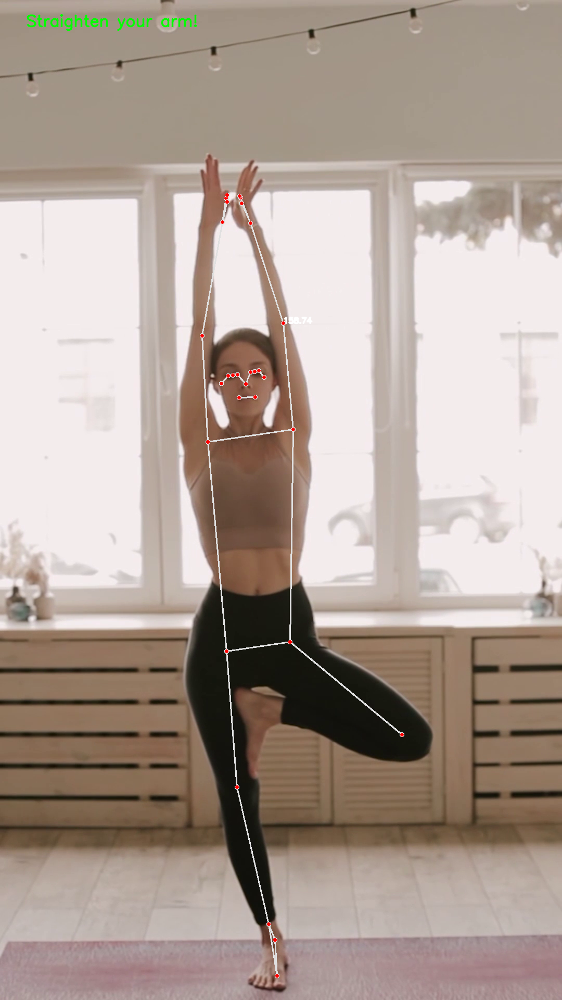

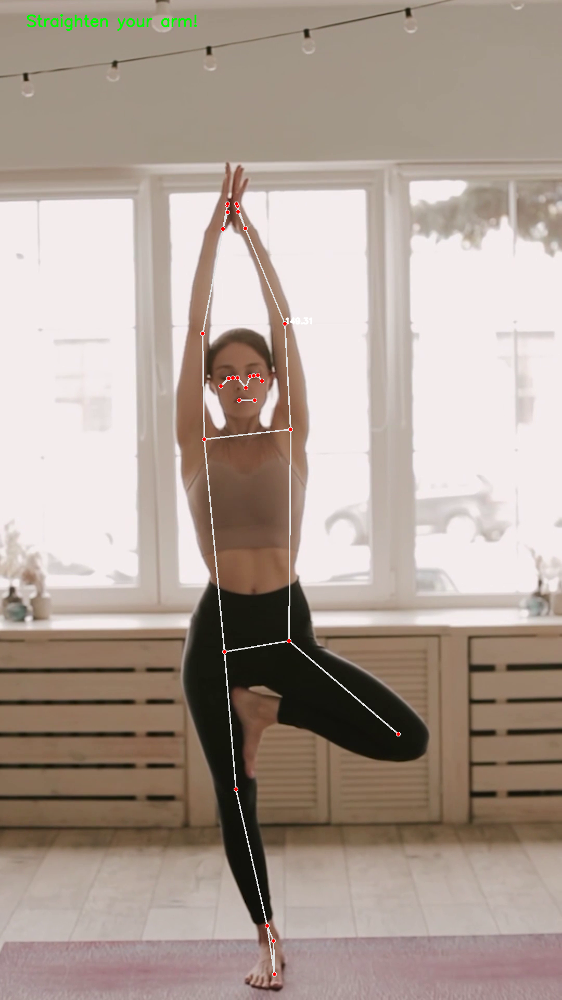

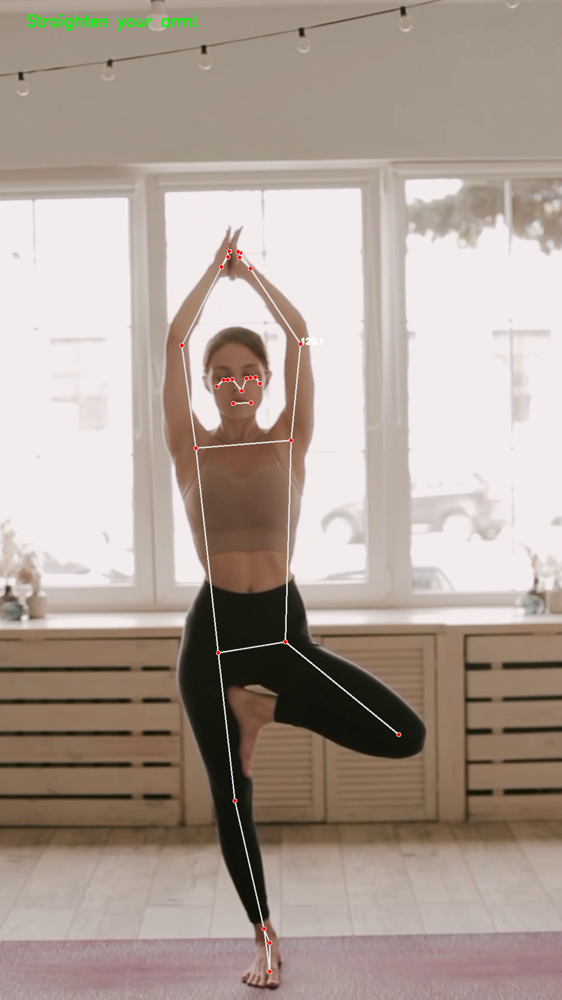

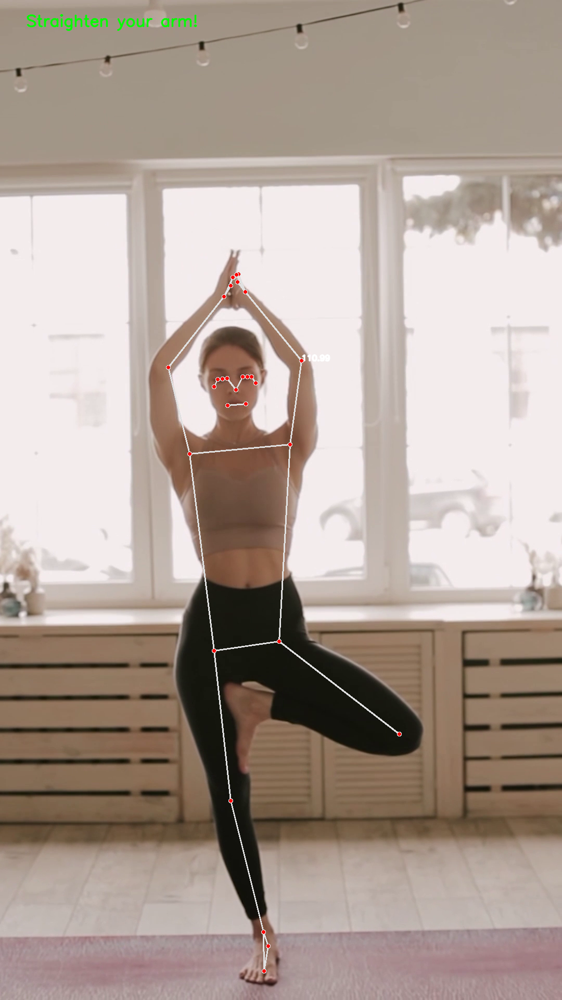

...

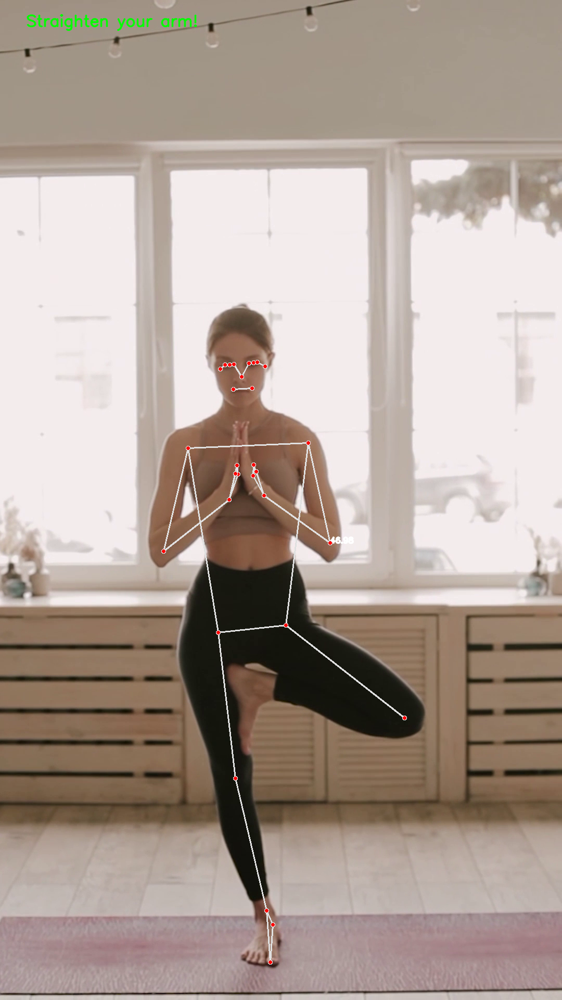

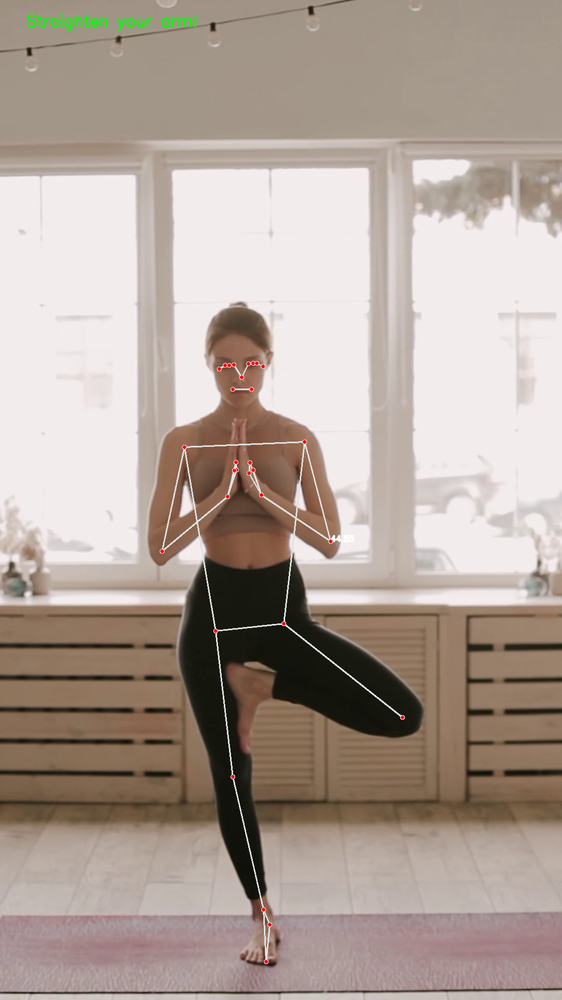

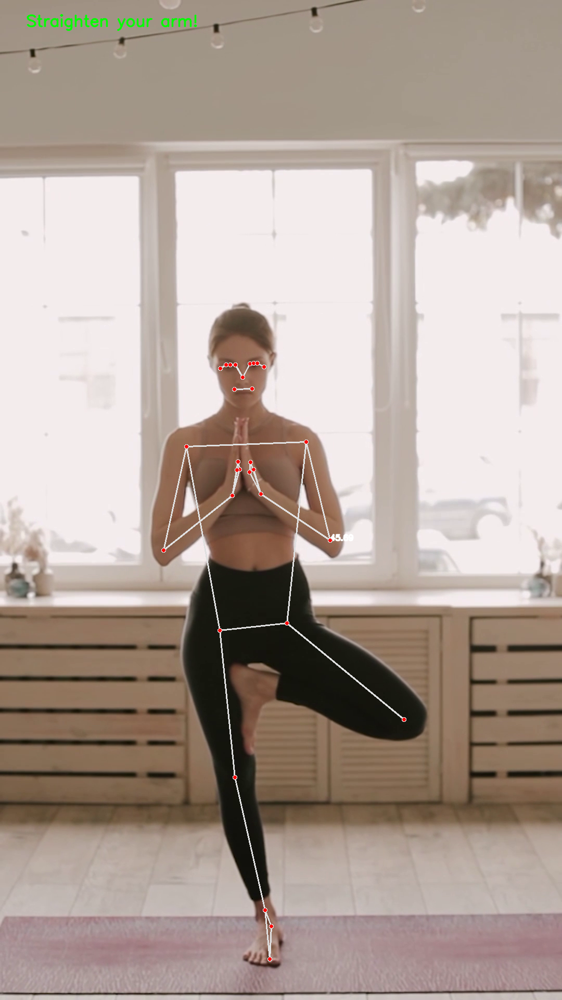

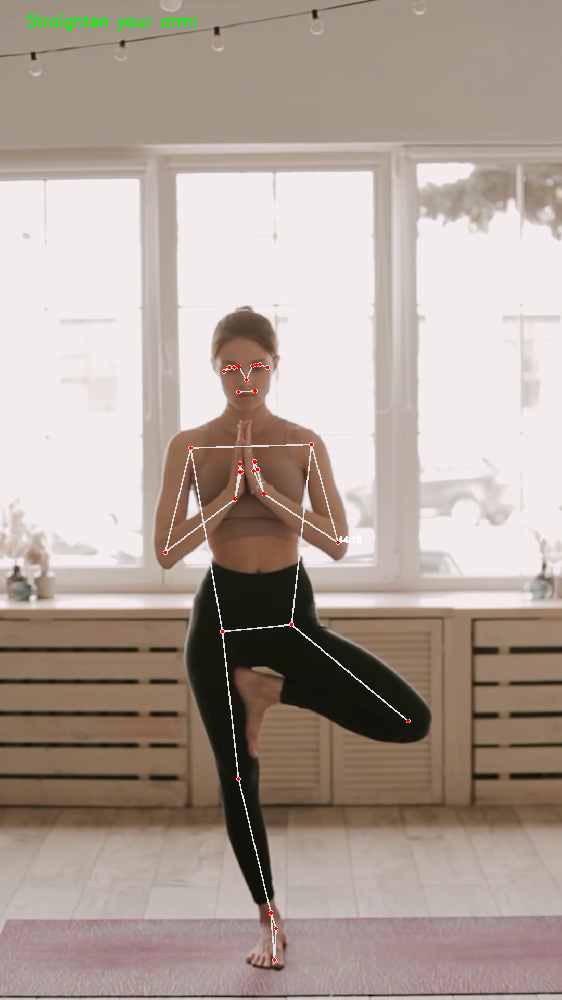

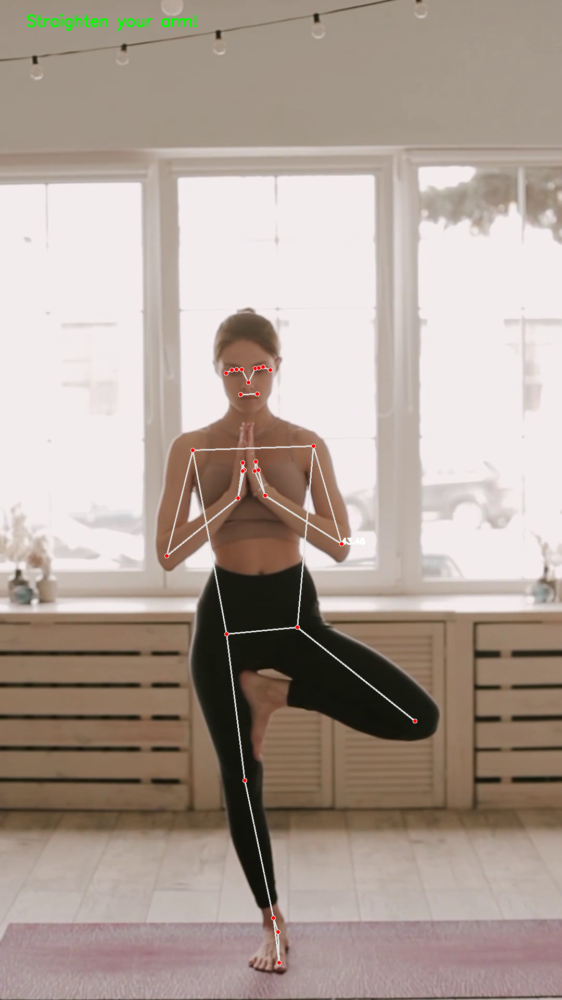

Video processing complete.


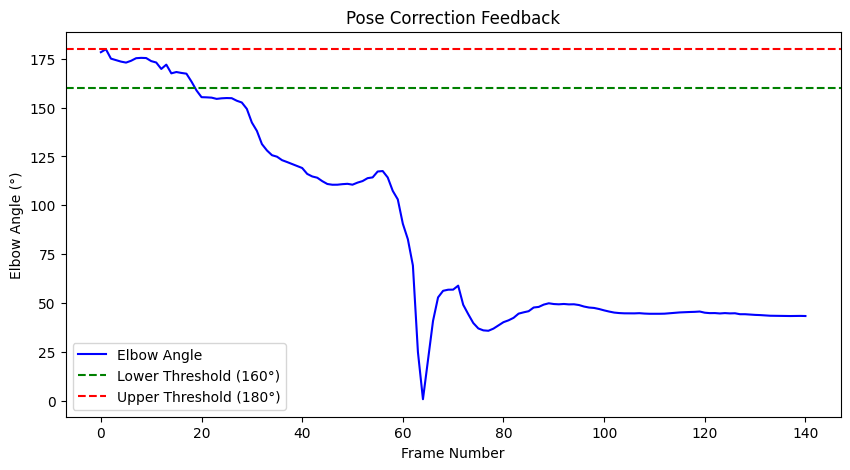

In [5]:
import cv2
import mediapipe as mp
import numpy as np
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

# Initialize MediaPipe
mp_pose = mp.solutions.pose
mp_drawing = mp.solutions.drawing_utils

# Function to calculate angle between three points
def calculate_angle(a, b, c):
    a = np.array(a)  # First point
    b = np.array(b)  # Middle point
    c = np.array(c)  # End point

    radians = np.arctan2(c[1] - b[1], c[0] - b[0]) - np.arctan2(a[1] - b[1], a[0] - b[0])
    angle = np.abs(radians * 180.0 / np.pi)

    if angle > 180.0:
        angle = 360 - angle

    return angle

# Function to process the video and provide feedback
def process_video_with_feedback(video_path):
    cap = cv2.VideoCapture(video_path)
    feedback_data = []  # To store angles for visualization

    # Initialize Pose Model
    with mp_pose.Pose(min_detection_confidence=0.5, min_tracking_confidence=0.5) as pose:
        frame_count = 0
        while cap.isOpened():
            ret, frame = cap.read()
            if not ret:
                print("Video processing complete.")
                break

            # Convert frame to RGB
            image = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
            image.flags.writeable = False

            # Make detections
            results = pose.process(image)

            # Convert back to BGR for OpenCV
            image.flags.writeable = True
            image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)

            # Draw landmarks and calculate feedback
            try:
                landmarks = results.pose_landmarks.landmark

                # Extract keypoints for left arm (example: shoulder, elbow, wrist)
                left_shoulder = [landmarks[mp_pose.PoseLandmark.LEFT_SHOULDER.value].x,
                                 landmarks[mp_pose.PoseLandmark.LEFT_SHOULDER.value].y]
                left_elbow = [landmarks[mp_pose.PoseLandmark.LEFT_ELBOW.value].x,
                              landmarks[mp_pose.PoseLandmark.LEFT_ELBOW.value].y]
                left_wrist = [landmarks[mp_pose.PoseLandmark.LEFT_WRIST.value].x,
                              landmarks[mp_pose.PoseLandmark.LEFT_WRIST.value].y]

                # Calculate angle at the elbow
                angle = calculate_angle(left_shoulder, left_elbow, left_wrist)
                feedback_data.append(angle)

                # Add feedback text
                feedback_text = "Good Pose!" if 160 <= angle <= 180 else "Straighten your arm!"
                cv2.putText(image, feedback_text, (50, 50), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 2, cv2.LINE_AA)

                # Annotate angle on the video
                cv2.putText(image, str(round(angle, 2)),
                            tuple(np.multiply(left_elbow, [frame.shape[1], frame.shape[0]]).astype(int)),
                            cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255, 255, 255), 2, cv2.LINE_AA)
            except:
                pass

            # Draw pose landmarks
            mp_drawing.draw_landmarks(image, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)

            # Display the frame in Colab every 10th frame
            frame_count += 1
            if frame_count % 10 == 0:
                cv2_imshow(image)

        cap.release()

    # Plot feedback data (angles over time)
    plt.figure(figsize=(10, 5))
    plt.plot(feedback_data, label="Elbow Angle", color="blue")
    plt.axhline(160, color="green", linestyle="--", label="Lower Threshold (160°)")
    plt.axhline(180, color="red", linestyle="--", label="Upper Threshold (180°)")
    plt.title("Pose Correction Feedback")
    plt.xlabel("Frame Number")
    plt.ylabel("Elbow Angle (°)")
    plt.legend()
    plt.show()

# Process the uploaded video
process_video_with_feedback(video_path)
